# Import

In [ ]:
import pandas as pd
import re
pd.options.display.float_format = '{:,.2f}'.format
from sklearn.metrics import auc, roc_auc_score, log_loss
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import plotly.express as px
import nltk
from nltk.tokenize import RegexpTokenizer
tokenizer = RegexpTokenizer(r'\w+')
nltk.download('stopwords')
from nltk.corpus import stopwords
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from sklearn.preprocessing import MinMaxScaler
import xgboost as xgb
from xgboost import XGBClassifier, plot_importance
import warnings
from sklearn.metrics import classification_report, confusion_matrix, plot_roc_curve
warnings.filterwarnings('ignore') #hide the warnings

# Load the Data 

The data consists information about Kickstarter (crowdfunding platform) projects.
[Data link](https://www.kaggle.com/kemical/kickstarter-projects)

Our main task is to predict if a project will be successful before it is released

In [2]:
df = pd.read_csv('ks-projects-201801.csv')

# Knowing your Data

The most important step is to know and feel your data. You need to inspect the data and its properties: data shape, data types, compute descriptive statistics, etc.

> **.info()** helps us to know the shape and the data types,along with finding whether they contain null values or not. Dataset comprises of 378,661 observations and 15 characteristics.

In [3]:
df.info(null_counts=True) #"null counts" provides the null amount of each column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378661 entries, 0 to 378660
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ID                378661 non-null  int64  
 1   name              378657 non-null  object 
 2   category          378661 non-null  object 
 3   main_category     378661 non-null  object 
 4   currency          378661 non-null  object 
 5   deadline          378661 non-null  object 
 6   goal              378661 non-null  float64
 7   launched          378661 non-null  object 
 8   pledged           378661 non-null  float64
 9   state             378661 non-null  object 
 10  backers           378661 non-null  int64  
 11  country           378661 non-null  object 
 12  usd pledged       374864 non-null  float64
 13  usd_pledged_real  378661 non-null  float64
 14  usd_goal_real     378661 non-null  float64
dtypes: float64(5), int64(2), object(8)
memory usage: 43.3+ MB


> To take a closer look at the data I recommend to use **.head()** which returns first five samples of the data set. <br> Similarly  **.tail()** returns last five samples of the data set.

In [4]:
df.head()

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
0,1000002330,The Songs of Adelaide & Abullah,Poetry,Publishing,GBP,2015-10-09,"1,000.00",2015-08-11 12:12:28,0.00,failed,0,GB,0.00,0.00,"1,533.95"
1,1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,"30,000.00",2017-09-02 04:43:57,"2,421.00",failed,15,US,100.00,"2,421.00","30,000.00"
2,1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,"45,000.00",2013-01-12 00:20:50,220.00,failed,3,US,220.00,220.00,"45,000.00"
3,1000007540,ToshiCapital Rekordz Needs Help to Complete Album,Music,Music,USD,2012-04-16,"5,000.00",2012-03-17 03:24:11,1.00,failed,1,US,1.00,1.00,"5,000.00"
4,1000011046,Community Film Project: The Art of Neighborhoo...,Film & Video,Film & Video,USD,2015-08-29,"19,500.00",2015-07-04 08:35:03,"1,283.00",canceled,14,US,"1,283.00","1,283.00","19,500.00"


# EDA

In this stage, we are performing initial investigations on data so as to discover multicollinearity, to recognize patterns and to spot anomalies using statistical graphics and data visualization methods. <br>
This step is varied and may be extensive. I chose to present several major methods, but you can dive deeper into the data analysis.

In [3]:
df['ID'] = df['ID'].astype(str)

> You can generate descriptive statistics using **describe()** function. This function returns the count, mean, standard deviation, minimum and maximum values and the quantiles of the data. <br>
Here as you can notice mean value is higher than median (50%) value of each column. Moreover, there is notably a large difference between 75th and max values of each columns. Thus observations suggests that there are outliers in our data set.

In [6]:
df.describe()

,goal,pledged,backers,usd pledged,usd_pledged_real,usd_goal_real
count,"378,661.00","378,661.00","378,661.00","374,864.00","378,661.00","378,661.00"
mean,"49,080.79","9,682.98",105.62,"7,036.73","9,058.92","45,454.40"
std,"1,183,391.26","95,636.01",907.19,"78,639.75","90,973.34","1,152,950.06"
min,0.01,0.00,0.00,0.00,0.00,0.01
25%,"2,000.00",30.00,2.00,16.98,31.00,"2,000.00"
50%,"5,200.00",620.00,12.00,394.72,624.33,"5,500.00"
75%,"16,000.00","4,076.00",56.00,"3,034.09","4,050.00","15,500.00"
max,"100,000,000.00","20,338,986.27","219,382.00","20,338,986.27","20,338,986.27","166,361,390.71"


## Transform "state" to Binary Label

Our task is to predict if a project will succeed or not. So, we should transform the "state" column to binary. First, we look at the counts of unique values of "state". Then, we define any state, excluding "successful", as "failed"

> The **value_counts()** function tells us the relative frequencies of each state value in descending order. It observed that "failed" and "successful" are the most common state, and a few observations made for "canceled", "live" and "suspended".

In [4]:
df['state'].value_counts(normalize=True)

failed       0.52
successful   0.35
canceled     0.10
undefined    0.01
live         0.01
suspended    0.00
Name: state, dtype: float64

In [5]:
df['binary_state'] = df['state'].apply(lambda x: 1 if x =='successful' else 0)

## Analyze Numric Features

### Correlation 

Here, we compute the pairwise correlation of numeric columnsin order to find highly correlated features with the target or multicollinearity. <br> Dark color represents positive correlation while the lighter color represents negative correlation.  <br> We can infer that "usd_pledged" and "pledged" have a strong positive correlation with "usd_pledged_real". Similarly, "goal" and "usd_goal_real" have a positive correlation. Logically, "pledged" also has a high correlation with "backers". <br> We should consider those correlations on the features selection stage.

<AxesSubplot:>

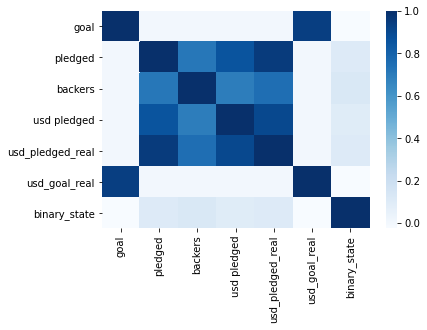

In [12]:
sns.heatmap(df.corr(), cmap='Blues')

### Histogram

Display histogram of all the continuous features. A histogram allows us to see the distribution of a particular variable

array([[<AxesSubplot:title={'center':'goal'}>,
        <AxesSubplot:title={'center':'pledged'}>,
        <AxesSubplot:title={'center':'backers'}>],
       [<AxesSubplot:title={'center':'usd pledged'}>,
        <AxesSubplot:title={'center':'usd_pledged_real'}>,
        <AxesSubplot:title={'center':'usd_goal_real'}>],
       [<AxesSubplot:title={'center':'binary_state'}>, <AxesSubplot:>,
        <AxesSubplot:>]], dtype=object)

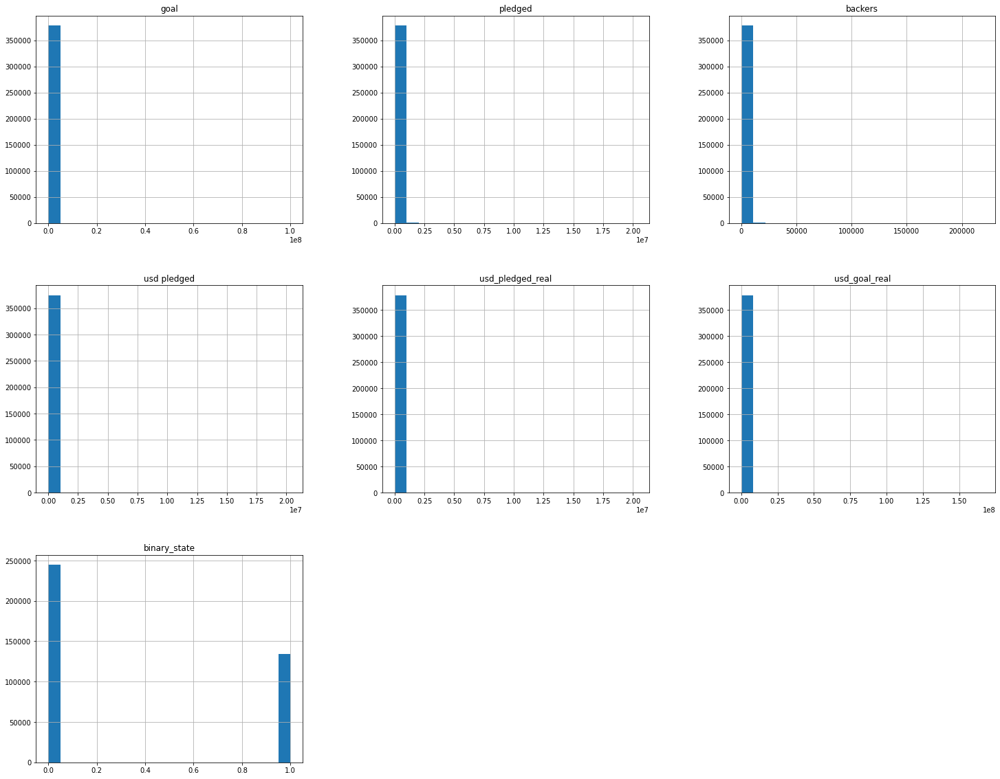

In [13]:
df.hist(bins=20,figsize=(25, 20),)

### Boxplot

A box plot shows the distribution of quantitative data. It can tell you about outliers and how the data skewed. More information abount Boxplot can be found [here](https://towardsdatascience.com/understanding-boxplots-5e2df7bcbd51) 

<AxesSubplot:xlabel='binary_state', ylabel='usd_pledged_real'>

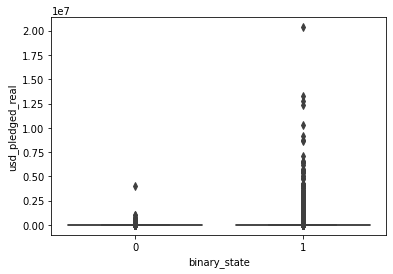

In [14]:
sns.boxplot(x= 'binary_state',y = 'usd_pledged_real', data=df)
#df['backers'].hist()

> Since our data is highly skewed, we can use "log" on the y-axis to better visualize the data. <br> Here, we can observe that "usd_pledged_real" differently distributes between successful and failed projects.

In [7]:
px.box(x= 'binary_state',y = 'usd_pledged_real', data_frame=df,log_y=True)

> As the goal average of a "failed" projects is higher than a "successful" projects, we can infer that a project may fail when its goal is too high.

In [8]:
px.box(x= 'binary_state',y = 'usd_goal_real', data_frame=df,log_y=True)

## Analyze Categorial Data

Here I use a bar plot to show labels frequency over project's category. <br> The highest success rate is received by "Dance" and "Theater" categories.

<AxesSubplot:xlabel='main_category', ylabel='binary_state'>

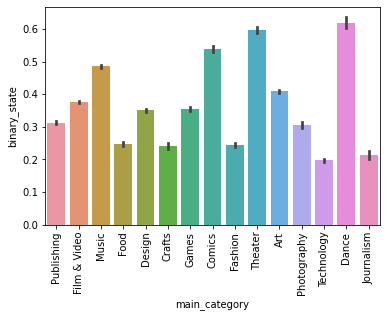

In [34]:
plt.xticks(rotation='90')
sns.barplot(x='main_category', y= 'binary_state', data=df)

## Text Analysis

Word Clouds are visual representations of words that give greater prominence to words that appear more frequently. <br> Here I use it to find the most common words in the Kickstarter projects names. 

(-0.5, 399.5, 199.5, -0.5)

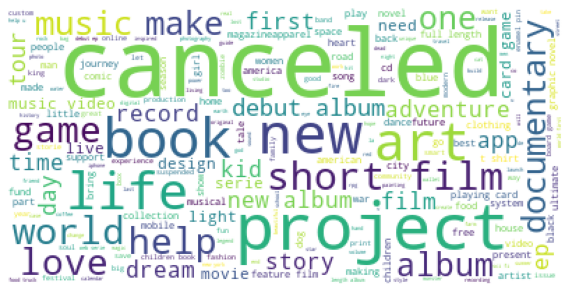

In [18]:
words = [i.lower() for i in df.name.dropna() if i not in(STOPWORDS)]
words = " ".join(words)
wordcloud = WordCloud(background_color='white').generate(words)
plt.figure(figsize = (10, 10), facecolor = None) 
plt.imshow(wordcloud)
plt.axis('off')

# Missing Values 

The handling of missing data is very important during the preprocessing of the dataset as many machine learning algorithms do not support missing values.

> First, we look at samples with NaN values and try to find reasons for missing data. <br> Here, we have 3801 samples with NaN values in any column. We can observe that "NaN" values probably follow "undefined" state as well as "N,0"" country.

In [27]:
# Display rows with one or more NaN values
df[df.isna().any(axis=1)]

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,...,binary_state,weekday_deadline,monthday_deadline,month_deadline,year_deadline,weekday_launched,monthday_launched,month_launched,year_launched,hour_launched
169,1000694855,STREETFIGHTERZ WHEELIE MURICA,Film & Video,Film & Video,USD,2014-09-20,"6,500.00",2014-08-06 21:28:36,555.00,undefined,...,0,5,20,9,2014,2,6,8,2014,21
328,100149523,Duncan Woods - Chameleon EP,Music,Music,AUD,2015-08-25,"4,500.00",2015-08-04 12:05:17,"4,767.00",undefined,...,0,1,25,8,2015,1,4,8,2015,12
632,1003023003,The Making of Ashley Kelley's Debut Album,Music,Music,USD,2015-04-09,"3,500.00",2015-03-10 20:06:13,"3,576.00",undefined,...,0,3,9,4,2015,1,10,3,2015,20
647,1003130892,Butter Side Down Debut Album,Music,Music,USD,2015-11-26,"6,000.00",2015-11-02 22:09:19,"7,007.80",undefined,...,0,3,26,11,2015,0,2,11,2015,22
749,1003629045,Chase Goehring debut EP,Music,Music,USD,2016-03-21,"3,000.00",2016-02-23 03:09:49,"3,660.38",undefined,...,0,0,21,3,2016,1,23,2,2016,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
378233,997971307,"EQUUS International Film Festival®, all-equine...",Film & Video,Film & Video,USD,2015-02-03,"7,500.00",2014-12-05 04:19:14,10.00,undefined,...,0,1,3,2,2015,4,5,12,2014,4
378303,998319149,Emily 2050 - Short Film,Film & Video,Film & Video,CAD,2014-05-23,"3,000.00",2014-04-08 00:30:09,"3,102.00",undefined,...,0,4,23,5,2014,1,8,4,2014,0
378434,9988744,Matthew Stephens Music,Music,Music,USD,2016-02-05,"5,000.00",2016-01-06 21:59:23,235.00,undefined,...,0,4,5,2,2016,2,6,1,2016,21
378585,999610349,Lady Vendredi: Afrofuturist concept 12 inch EP,Music,Music,GBP,2015-10-19,"2,000.00",2015-09-21 22:33:18,"2,125.00",undefined,...,0,0,19,10,2015,0,21,9,2015,22


I chose to present two ways to impute missing values:
* Delete Rows with Missing Values: it creates a robust model, but we may lose a lot of information.
* Assigning a default value. <br>
There are many other ways to handling missing values, such as replacing them with mean/median/mod, predicting the missing values, etc.
You should consider the best way depend on your data and task. 


In [6]:
# remove all the rows that contain a missing value
df = df.dropna()

In [27]:
# replace all NA's with 0
df.fillna(0, inplace=False) # if you want to update the df, you can use 'inplace=True'

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,...,binary_state,weekday_deadline,monthday_deadline,month_deadline,year_deadline,weekday_launched,monthday_launched,month_launched,year_launched,hour_launched
0,1000002330,The Songs of Adelaide & Abullah,Poetry,Publishing,GBP,2015-10-09,"1,000.00",2015-08-11 12:12:28,0.00,failed,...,0,4,9,10,2015,1,11,8,2015,12
1,1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,"30,000.00",2017-09-02 04:43:57,"2,421.00",failed,...,0,2,1,11,2017,5,2,9,2017,4
2,1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,"45,000.00",2013-01-12 00:20:50,220.00,failed,...,0,1,26,2,2013,5,12,1,2013,0
3,1000007540,ToshiCapital Rekordz Needs Help to Complete Album,Music,Music,USD,2012-04-16,"5,000.00",2012-03-17 03:24:11,1.00,failed,...,0,0,16,4,2012,5,17,3,2012,3
4,1000011046,Community Film Project: The Art of Neighborhoo...,Film & Video,Film & Video,USD,2015-08-29,"19,500.00",2015-07-04 08:35:03,"1,283.00",canceled,...,0,5,29,8,2015,5,4,7,2015,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
378656,999976400,ChknTruk Nationwide Charity Drive 2014 (Canceled),Documentary,Film & Video,USD,2014-10-17,"50,000.00",2014-09-17 02:35:30,25.00,canceled,...,0,4,17,10,2014,2,17,9,2014,2
378657,999977640,The Tribe,Narrative Film,Film & Video,USD,2011-07-19,"1,500.00",2011-06-22 03:35:14,155.00,failed,...,0,1,19,7,2011,2,22,6,2011,3
378658,999986353,Walls of Remedy- New lesbian Romantic Comedy f...,Narrative Film,Film & Video,USD,2010-08-16,"15,000.00",2010-07-01 19:40:30,20.00,failed,...,0,0,16,8,2010,3,1,7,2010,19
378659,999987933,BioDefense Education Kit,Technology,Technology,USD,2016-02-13,"15,000.00",2016-01-13 18:13:53,200.00,failed,...,0,5,13,2,2016,2,13,1,2016,18


# Feature Engineering

In this stage we extract features from raw data. Our goal is to improve the performance of machine learning models by providing him insightful features.

## Time Features

Though date columns usually provide valuable information about the model target, they are hard to understand by algorithms due to their format. So, the prepossessing is very important.

In [7]:
# Transform string to date
df['deadline'] = pd.to_datetime(df['deadline'])
df['launched'] = pd.to_datetime(df['launched'])

In [8]:
# extract parts of the date
def time_features(df, column):
    df[f'weekday_{column}'] = df[column].dt.dayofweek
    df[f'monthday_{column}'] = df[column].dt.day
    df[f'month_{column}'] = df[column].dt.month
    df[f'year_{column}'] = df[column].dt.year
    return df

In [9]:
df = time_features(df, 'deadline')
df = time_features(df, 'launched')
df['hour_launched'] = df['launched'].dt.hour

> I like to visualise the target variable mean over week days and hours.  <br> Here I chose to examine the success rate across the project launched time. We can see that The hourly "success" pattern looks pretty similar every day. However, there are a couple of peak hours e.g. 6, 9 and 15. 

<AxesSubplot:xlabel='hour_launched', ylabel='binary_state'>

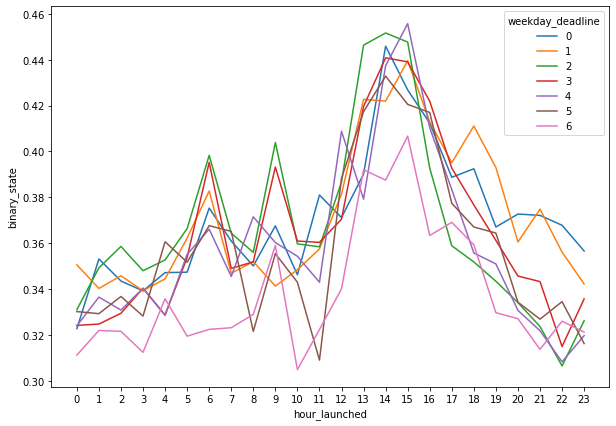

In [10]:
plt.figure(figsize = (10, 7), facecolor = None)
plt.xticks(df['hour_launched'].unique())
sns.lineplot(x='hour_launched', y='binary_state', data=df , hue='weekday_deadline', err_style=None, palette='tab10')

## Text Features

Preparing raw text data to make it suitable for a machine learning model, including text cleaning, stopwords removal etc.

In [11]:
stop = stopwords.words('english')

In [12]:
def avg_word(sentence):
    words = sentence.split()
    return (sum(len(word) for word in words)/len(words))

In [13]:
df['count_words']= df['name'].apply(lambda text: len(tokenizer.tokenize(text))) # counts the number of tokens in the text (separated by a space)
df['stopwords'] = df['name'].apply(lambda x: len([x for x in x.split() if x.lower() in stop])) #counts the number of stop words in the text 
df['avg_word'] = df['name'].apply(lambda x: avg_word(x)) # average of word length: sum of words length divided by the number of words (character count/word count)

# Train & Test

## Features Selection

Select features based on the insights from the EDA and features engineering stages.

In [14]:
num_features = ['usd_goal_real','count_words','stopwords', 'avg_word','weekday_deadline', 'monthday_deadline', 'month_deadline',
       'year_deadline', 'weekday_launched', 'monthday_launched',
       'month_launched', 'year_launched', 'hour_launched']
cat_features = ['category','main_category','country']
features=num_features+cat_features

In [15]:
# Split into train and test
train, test = train_test_split(df,random_state=42,test_size=0.3,)

In [16]:
y_train=train['binary_state']
y_test=test['binary_state']
X_train= train.filter(features, axis=1)
X_test= test.filter(features, axis=1)

## One Hot Encoding  

Most machine learning algorithms can't work with categorical data directly. This means that categorical data must be converted to a numerical form. There are various types of categorical data encoding methods, e.g., Label Encoding and Target Encoding. 
<br> Here I use One Hot Encoding method. This method spreads the values in a categorical column to multiple binary columns. These binary values express the relationship between grouped and encoded columns.

In [17]:
X_train= pd.get_dummies(X_train)
X_test= pd.get_dummies(X_test)


#Align the number of features across test set based on train dataset
X_train, X_test = X_train.align(X_test, join='inner', axis=1)  

## Scaling

In most cases, the numerical features spanning varying ranges and units. This fact may be a significant obstacle to several machine learning algorithms such as gradient descent based and distances based algorithms.
So, Normalization and Standardization solve this problem. 
<br> Here I chose to use min-max normalization, but you can use Standardization methods like StandardScaler, depend on your task and the machine learning algorithm you are using.

In [18]:
scaler = MinMaxScaler()
for f in num_features:
    scaler = MinMaxScaler()
    X_train[f] = scaler.fit_transform(X_train[f].values.reshape(-1,1))
    X_test[f] = scaler.transform(X_test[f].values.reshape(-1,1))

# Training the Model

In this section we train the model on our data and evaluate the performances.

In [20]:
xgb = XGBClassifier() 
xgb.fit(X_train, y_train)

[08:44:44] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

# Evaluation 

In [21]:
y_probs = xgb.predict_proba(X_test)[:,1]
logloss = log_loss(y_test, y_probs)
roc_auc = roc_auc_score(y_test, y_probs)
print(f'auc: {roc_auc:0.2f} ,  log-loss: {logloss:0.2f}')

auc: 0.76 ,  log-loss: 0.55


In [44]:
y_pred = xgb.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.74      0.85      0.79     72173
           1       0.63      0.45      0.53     40285

    accuracy                           0.71    112458
   macro avg       0.68      0.65      0.66    112458
weighted avg       0.70      0.71      0.70    112458



Text(0.5, 1.0, 'Confusion Matrix')

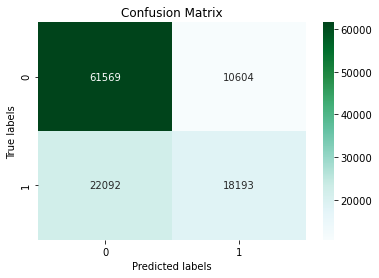

In [63]:
labels= sorted(list(set(y_train)))
cm= confusion_matrix(y_test,y_pred,labels=labels)
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax,cmap="BuGn",fmt='d'); #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels') 
ax.set_title('Confusion Matrix') 


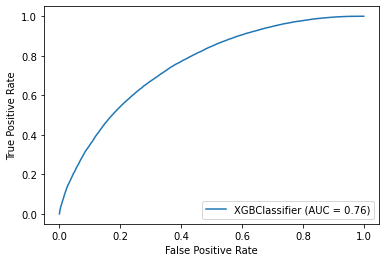

In [53]:
plot_roc_curve(xgb, X_test, y_test)  

> In many business cases, it is equally important to have an accurate and interpretable model. That is, we want to know which features are most important in determining the forecast. Feature importance analysis helping us with model interpretation

<AxesSubplot:>

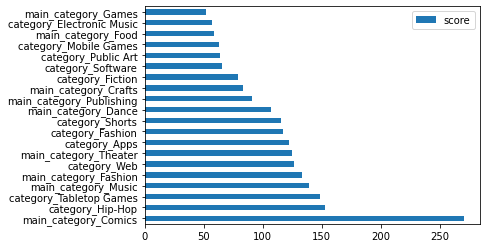

In [23]:
feature_important = xgb.get_booster().get_score(importance_type='gain')
keys = list(feature_important.keys())
values = list(feature_important.values())

data = pd.DataFrame(data=values, index=keys, columns=["score"]).sort_values(by = "score", ascending=False).head(20)
data.plot(kind='barh')